In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import easyocr
import cv2
import re

In [9]:
diabetes_df = pd.read_csv("diabetes.csv")
diabetes_df.sample(5)


,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
116,5,124,74,0,0,34.0,0.220,38,1
555,7,124,70,33,215,25.5,0.161,37,0
758,1,106,76,0,0,37.5,0.197,26,0
445,0,180,78,63,14,59.4,2.420,25,1
500,2,117,90,19,71,25.2,0.313,21,0


In [10]:
diabetes_df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 768 entries, 0 to 767
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Pregnancies               768 non-null    int64  
 1   Glucose                   768 non-null    int64  
 2   BloodPressure             768 non-null    int64  
 3   SkinThickness             768 non-null    int64  
 4   Insulin                   768 non-null    int64  
 5   BMI                       768 non-null    float64
 6   DiabetesPedigreeFunction  768 non-null    float64
 7   Age                       768 non-null    int64  
 8   Outcome                   768 non-null    int64  
dtypes: float64(2), int64(7)
memory usage: 54.1 KB


In [11]:
diabetes_df.describe()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
count,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000
mean,3.845052,120.894531,69.105469,20.536458,79.799479,31.992578,0.471876,33.240885,0.348958
std,3.369578,31.972618,19.355807,15.952218,115.244002,7.884160,0.331329,11.760232,0.476951
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.078000,21.000000,0.000000
25%,1.000000,99.000000,62.000000,0.000000,0.000000,27.300000,0.243750,24.000000,0.000000
50%,3.000000,117.000000,72.000000,23.000000,30.500000,32.000000,0.372500,29.000000,0.000000
75%,6.000000,140.250000,80.000000,32.000000,127.250000,36.600000,0.626250,41.000000,1.000000
max,17.000000,199.000000,122.000000,99.000000,846.000000,67.100000,2.420000,81.000000,1.000000


In [12]:
(diabetes_df == 0).sum()

,0
Pregnancies,111
Glucose,5
BloodPressure,35
SkinThickness,227
Insulin,374
BMI,11
DiabetesPedigreeFunction,0
Age,0
Outcome,500


In [13]:
!pip install easyocr opencv-python-headless

In [8]:
from google.colab import files

uploaded = files.upload()

Saving diabetes.csv to diabetes.csv


In [14]:
from google.colab import files
files.upload()


Saving AHD-0425-PA-0007719_E-REPORTS_250427_2032@E.pdf_page_4.png to AHD-0425-PA-0007719_E-REPORTS_250427_2032@E.pdf_page_4.png
Saving AHD-0425-PA-0007719_E-REPORTS_250427_2032@E.pdf_page_7.png to AHD-0425-PA-0007719_E-REPORTS_250427_2032@E.pdf_page_7.png
Saving AHD-0425-PA-0008061_E-mahendrasinghdischargecard_250427_1114@E.pdf_page_13.png to AHD-0425-PA-0008061_E-mahendrasinghdischargecard_250427_1114@E.pdf_page_13.png
Saving AHD-0425-PA-0008061_E-mahendrasinghdischargecard_250427_1114@E.pdf_page_27.png to AHD-0425-PA-0008061_E-mahendrasinghdischargecard_250427_1114@E.pdf_page_27.png


{'AHD-0425-PA-0007719_E-REPORTS_250427_2032@E.pdf_page_4.png': b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x06u\x00\x00\t#\x08\x02\x00\x00\x00X\x9c]\x91\x00\x00 \x00IDATx\x01\xd4\xc1]\xac,YY?\xfeo\xad\xf5T}\xab\xabwu\xf7\xee\xbdg\xf6\xbc\x9e\x03G\x07\x18\x0c/\x12b\x14\x82\xe1H4\x1a|\t$D\rz\xa5\x84xc0&D\xc3\x8d1^p\xc1\x8d(xe\xb8C\xbd\xd0\x04\tQ\x83Q/\x0c\x1a\xa3\x82\x9000D\x9c\x19\xe60g\x9f\xfd\xde\xbd\xbb\xba\x9e\xaa\xb5\xaa~L%\x93\xb0\xa8\x99\xff.:}\xce\xff\xf0\xf9DeY\xa2g\xb1X 4\x99L\xb0)\x92\x00\x9csUU\xd5\x9d<\xcf1\xc0b\xb10\xc6\x88H\x1c\xc7i\x9a\x1ac\x00\xa8*6B\x12\x9bRUl\x84$\xee9UE\x0fI\xdcM\x9f\xfd\xecg\xff\xf2/\xff\xf2\xd3\x9f\xfe\xf4\xc1\xc1\xc1\x1f\xfd\xd1\x1f\xbd\xef}\xef\x9bN\xa7\xaa\x1a\xc7\xb11\x06\x9d\xb6m\xa3(\xc2\xfdJU\xd1C\x12!U\xc5\x00$1\x80\xaa\xa2\x87$\xee&UE\x0fI\x84T\x15\x03<\xff\xfc\xf3\xc6\x98$IF\xa3Q\x1c\xc7"b\x8c!\x89\x90\xaab\x00\x92\xe8QUl\x84$6\xe2\x9c\xf3\xde\xe3*\xd6Z\x11AHU\xb1\x11\xed 4\x99L\xb0=$\xb1=GGG\xc6\x98$IF\xa3\x91\x88\xe0\x15\xa8*B\xd6Z\x1

In [15]:
import os

os.listdir()


['.config',
 'AHD-0425-PA-0007719_E-REPORTS_250427_2032@E.pdf_page_4.png',
 'diabetes.csv',
 'AHD-0425-PA-0007719_E-REPORTS_250427_2032@E.pdf_page_7.png',
 'AHD-0425-PA-0008061_E-mahendrasinghdischargecard_250427_1114@E.pdf_page_27.png',
 'AHD-0425-PA-0008061_E-mahendrasinghdischargecard_250427_1114@E.pdf_page_13.png',
 'sample_data']

(np.float64(-0.5), np.float64(1652.5), np.float64(2338.5), np.float64(-0.5))

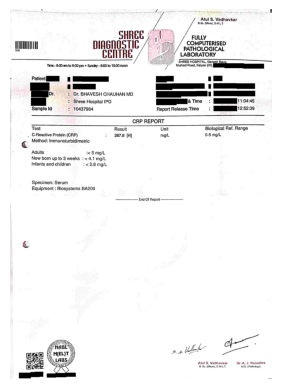

In [16]:
import cv2
import matplotlib.pyplot as plt

image_name = "AHD-0425-PA-0007719_E-REPORTS_250427_2032@E.pdf_page_4.png"

img = cv2.imread(image_name)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.axis("off")


In [17]:
import easyocr

reader = easyocr.Reader(['en'])


Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.0% Complete

In [19]:

import cv2

image_name = "AHD-0425-PA-0007719_E-REPORTS_250427_2032@E.pdf_page_4.png"
image = cv2.imread(image_name)

image is not None


True

In [20]:
import easyocr

reader = easyocr.Reader(['en'])


In [21]:
results = reader.readtext(image, detail=1)


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:668: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)


In [22]:
ocr_text = [res[1] for res in results]
ocr_text


['Atul S, Vadhavkar',
 'B.So: (Mlcro); DML,T',
 '`',
 'SHREE',
 'FULLY',
 'dipGnOSTIC',
 'COMPUTERISED',
 '016',
 'PATHOLOGICAL',
 'CGnTRE',
 'LABORATORY',
 'SHREE HOSPITAL, Oanesh Bauq',
 'Tme : 8OOmm t 8.0pm',
 'Sndy-8001 120nn',
 'Murbad Road, Kalyan (W)',
 'Patient]',
 'Dr: BHAVESH CHAUHAN MD',
 'Shree Hospital IPD',
 'Tima',
 '11204.45',
 'Sample Id',
 '10437984',
 'Report Release Time',
 '12.52.39',
 'CRP REPORT',
 'Test',
 'Result',
 'Unit',
 'Biological Ref. Range',
 'C-Reactive Protein (CRP)',
 '267.8 [H]',
 'mg/L',
 '0-5 mg/L',
 'Method: Immunoturbidimetric',
 'Adults',
 '*5 mg/L',
 'New born up to 3 weeks',
 ':<4.1 mg/L',
 'Infants and children',
 '<2.8',
 'mg/L',
 'Specimen: Serum',
 'Equipment',
 'Biosystems BA2OO',
 'End Of Report',
 '',
 'NABL',
 '4 _',
 'M(EL)T',
 'LaBs',
 'Atul S. Vadhavkar',
 'Dr A. J. Ranadive',
 'B. Sc (Micro) DMLT',
 'MD (Palholagy)',
 '3',
 'UlA']

In [23]:
full_text = " ".join(ocr_text)
full_text


'Atul S, Vadhavkar B.So: (Mlcro); DML,T ` SHREE FULLY dipGnOSTIC COMPUTERISED 016 PATHOLOGICAL CGnTRE LABORATORY SHREE HOSPITAL, Oanesh Bauq Tme : 8OOmm t 8.0pm Sndy-8001 120nn Murbad Road, Kalyan (W) Patient] Dr: BHAVESH CHAUHAN MD Shree Hospital IPD Tima 11204.45 Sample Id 10437984 Report Release Time 12.52.39 CRP REPORT Test Result Unit Biological Ref. Range C-Reactive Protein (CRP) 267.8 [H] mg/L 0-5 mg/L Method: Immunoturbidimetric Adults *5 mg/L New born up to 3 weeks :<4.1 mg/L Infants and children <2.8 mg/L Specimen: Serum Equipment Biosystems BA2OO End Of Report  NABL 4 _ M(EL)T LaBs Atul S. Vadhavkar Dr A. J. Ranadive B. Sc (Micro) DMLT MD (Palholagy) 3 UlA'

In [25]:
import re

medical_data = {}

glucose = re.search(r'glucose[:\s]*([0-9]+)', full_text, re.IGNORECASE)
bp = re.search(r'blood pressure[:\s]*([0-9/]+)', full_text, re.IGNORECASE)
protein = re.search(r'protein[:\s]*([0-9]+)', full_text, re.IGNORECASE)
ph = re.search(r'ph[:\s]*([0-9.]+)', full_text, re.IGNORECASE)

if glucose:
    medical_data["Glucose"] = glucose.group(1)
if bp:
    medical_data["BloodPressure"] = bp.group(1)
if protein:
    medical_data["Protein"] = protein.group(1)
if ph:
    medical_data["pH"] = ph.group(1)

medical_data

{}

In [26]:
import pandas as pd

structured_ocr_df = pd.DataFrame([medical_data])
structured_ocr_df


""
0


In [28]:
print("Milestone 1 Completed Successfully")
print("Medical data was collected from CSV datasets and scanned medical reports.")
print("OCR was applied to extract text, and both numeric and textual data")
print("were converted into structured formats for further ML analysis.")


Milestone 1 Completed Successfully
Medical data was collected from CSV datasets and scanned medical reports.
OCR was applied to extract text, and both numeric and textual data
were converted into structured formats for further ML analysis.


In [ ]:
pip install easyocr